## Super Resolution Wasserstein Generative Adverserial Network with Gradient Penality and Structural Similiaity Index for Image Restoration

In [245]:
pip install pytorch_ssim

     |████████████████████████████████| 12.0 MB 4.9 MB/s 
Processing /colabtools/dist/google-colab-1.0.0.tar.gz
ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: '/colabtools/dist/google-colab-1.0.0.tar.gz'



In [210]:
pip install piqa

### Download Datasets

In [1]:
!wget http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
!unzip DIV2K_valid_HR.zip

--2022-05-21 19:31:14--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip [following]
--2022-05-21 19:31:14--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 448993893 (428M) [application/zip]
Saving to: ‘DIV2K_valid_HR.zip’

DIV2K_valid_HR.zip  100%[===================>] 428.19M  24.4MB/s    in 23s     

2022-05-21 19:31:38 (18.4 MB/s) - ‘DIV2K_valid_HR.zip’ saved [448993893/448993893]

Archive:  DIV2K_valid_HR.zip
   creating: DIV2K_valid_HR/
  inflating: DIV2K_valid_HR/0897.png  
  inflating: DIV2K_val

In [2]:
!wget http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
!unzip DIV2K_train_HR.zip

--2022-05-21 19:31:42--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip [following]
--2022-05-21 19:31:42--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3530603713 (3.3G) [application/zip]
Saving to: ‘DIV2K_train_HR.zip’

DIV2K_train_HR.zip  100%[===================>]   3.29G  24.8MB/s    in 2m 19s  

2022-05-21 19:34:02 (24.2 MB/s) - ‘DIV2K_train_HR.zip’ saved [3530603713/3530603713]

Archive:  DIV2K_train_HR.zip
   creating: DIV2K_train_HR/
  inflating: DIV2K_train_HR/0103.png  
  inflating: DIV2K_

### Import packages

In [209]:
import torch
import math
from os import listdir
import numpy as np
from torch.autograd import Variable
from torchvision.transforms import Compose, RandomCrop, ToTensor, ToPILImage, CenterCrop, Resize,Normalize
from torch.utils.data import DataLoader, Dataset
from PIL import Image
from os.path import join
from torch import nn, optim
from torchvision.models.vgg import vgg16
import matplotlib.pyplot as plt 
import torchvision.utils as utils
import torch
from math import log10 
from tqdm import tqdm
import os
from zipfile import ZipFile
from google.colab import files


In [211]:
torch.autograd.set_detect_anomaly(True)

#### Setting Upscale factor

In [212]:
UPSCALE_FACTOR = 4
CROP_SIZE = 96

In [213]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])

In [214]:
from torchvision.transforms import InterpolationMode

def is_image_file(filename):
    return any(filename.endswith(extension) for extension in ['.png', '.jpg', '.jpeg', '.PNG', '.JPG', '.JPEG'])


def calculate_valid_crop_size(crop_size, upscale_factor):
    return crop_size - (crop_size % upscale_factor)


def train_hr_transform(crop_size):
    return Compose([
        RandomCrop(crop_size),
        ToTensor()
    ])


def train_lr_transform(crop_size, upscale_factor):
    return Compose([
        ToPILImage(),
        Resize(crop_size // upscale_factor, interpolation=InterpolationMode.BICUBIC),
        ToTensor()

    ])


def display_transform():
    return Compose([
        ToPILImage(),
        Resize(400),
        CenterCrop(400),
        ToTensor()
    ])


class TrainDatasetFromFolder(Dataset):
    def __init__(self, dataset_dir, crop_size, upscale_factor):
        super(TrainDatasetFromFolder, self).__init__()
        self.image_filenames = [join(dataset_dir, x) for x in listdir(dataset_dir) if is_image_file(x)]
        crop_size = calculate_valid_crop_size(crop_size, upscale_factor)
        self.hr_transform = train_hr_transform(crop_size)
        self.lr_transform = train_lr_transform(crop_size, upscale_factor)

    def __getitem__(self, index):
        hr_image = self.hr_transform(Image.open(self.image_filenames[index]))
        lr_image = self.lr_transform(hr_image)
        return lr_image, hr_image

    def __len__(self):
        return len(self.image_filenames)

In [215]:
class ValDatasetFromFolder(Dataset):
    def __init__(self, dataset_dir, upscale_factor):
        super(ValDatasetFromFolder, self).__init__()
        self.upscale_factor = upscale_factor
        self.image_filenames = [join(dataset_dir, x) for x in listdir(dataset_dir) if is_image_file(x)]

    def __getitem__(self, index):
        hr_image = Image.open(self.image_filenames[index])
        w, h = hr_image.size
        crop_size = calculate_valid_crop_size(min(w, h), self.upscale_factor)
        lr_scale = Resize(crop_size // self.upscale_factor, interpolation=InterpolationMode.BICUBIC)
        hr_scale = Resize(crop_size, interpolation=InterpolationMode.BICUBIC)
        hr_image = CenterCrop(crop_size)(hr_image)
        lr_image = lr_scale(hr_image)
        hr_restore_img = hr_scale(lr_image)
        return ToTensor()(lr_image), ToTensor()(hr_restore_img), ToTensor()(hr_image)

    def __len__(self):
        return len(self.image_filenames)



In [216]:
train_set = TrainDatasetFromFolder("DIV2K_train_HR", crop_size=CROP_SIZE,
                                   upscale_factor=UPSCALE_FACTOR)
trainloader = DataLoader(train_set, batch_size=16, num_workers=4, shuffle=True)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.



## Designing the Architecture

### Residual Block

In [217]:

class ResidualBlock(nn.Module):
  def __init__(self, channels):
    super(ResidualBlock, self).__init__()
    self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
    self.bn1 = nn.BatchNorm2d(channels)
    self.prelu = nn.PReLU()
    self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
    self.bn2 = nn.BatchNorm2d(channels)
  def forward(self, x):
    residual = self.conv1(x)
    residual = self.bn1(residual)
    residual = self.prelu(residual)
    residual = self.conv2(residual)
    residual = self.bn2(residual)
    return x + residual
  
class UpsampleBlock(nn.Module):
  def __init__(self, in_channels, up_scale):
    super(UpsampleBlock, self).__init__()
    self.conv = nn.Conv2d(in_channels, in_channels * up_scale ** 2, 
                          kernel_size=3, padding=1)
    self.pixel_shuffle = nn.PixelShuffle(up_scale)
    self.prelu = nn.PReLU()
  def forward(self, x):
    x = self.conv(x)
    x = self.pixel_shuffle(x)
    x = self.prelu(x)
    return x

### Generator 

In [218]:
class Generator(nn.Module):
  def __init__(self, scale_factor):
    super(Generator, self).__init__()
    upsample_block_num = int(math.log(scale_factor, 2))

    self.block1 = nn.Sequential(
        nn.Conv2d(3, 64, kernel_size=9, padding=4),
        nn.PReLU()
    )

    self.block2 = ResidualBlock(64)
    self.block3 = ResidualBlock(64)
    self.block4 = ResidualBlock(64)
    self.block5 = ResidualBlock(64)
    self.block6 = ResidualBlock(64)
    self.block7 = nn.Sequential(
        nn.Conv2d(64, 64, kernel_size=3, padding=1),
        nn.BatchNorm2d(64)
    )
    block8 = [UpsampleBlock(64, 2) for _ in range(upsample_block_num)]
    block8.append(nn.Conv2d(64, 3, kernel_size=9, padding=4))
    self.block8 = nn.Sequential(*block8)
  def forward(self, x):
    block1 = self.block1(x)
    block2 = self.block2(block1)
    block3 = self.block3(block2)
    block4 = self.block4(block3)
    block5 = self.block5(block4)
    block6 = self.block6(block5)
    block7 = self.block7(block6)
    block8 = self.block8(block1 + block7)
    return (torch.tanh(block8) + 1) / 2

### Discriminator

In [219]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.net = nn.Sequential(
        nn.Conv2d(3, 64, kernel_size=3, padding=1),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(64),
        nn.LeakyReLU(0.2),

        nn.Conv2d(64, 128, kernel_size=3, padding=1),
        nn.BatchNorm2d(128),
        nn.LeakyReLU(0.2),

        nn.Conv2d(128, 256, kernel_size=3, padding=1),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(0.2),

        nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(0.2),

        nn.Conv2d(256, 512, kernel_size=3, padding=1),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(0.2),

        nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(0.2),

        nn.AdaptiveAvgPool2d(1),
        nn.Conv2d(512, 1024, kernel_size=1),
        nn.LeakyReLU(0.2),
        nn.Conv2d(1024, 1, kernel_size=1)
    )
  def forward(self, x):
    batch_size=x.size()[0]
    return self.net(x).view(batch_size)
    #return torch.sigmoid(self.net(x).view(batch_size))

### Designing Loss Functions

In [220]:
class TVLoss(nn.Module):
  def __init__(self, tv_loss_weight=1):
    super(TVLoss, self).__init__()
    self.tv_loss_weight=tv_loss_weight
  def forward(self, x):
    batch_size=x.size()[0]
    h_x = x.size()[2]
    w_x = x.size()[3]

    count_h = self.tensor_size(x[:, :, 1:, :])
    count_w = self.tensor_size(x[:, :, :, 1:])

    h_tv = torch.pow(x[:, :, 1:, :] - x[:, :, :h_x - 1, :], 2).sum()
    w_tv = torch.pow(x[:, :, :, 1:] - x[:, :, :, :w_x - 1], 2).sum()
    return self.tv_loss_weight * 2 * (h_tv / count_h + w_tv / count_w) / batch_size
  
  # Forgot to implement an important method
  @staticmethod # Must add this
  def tensor_size(t):
    return t.size()[1] * t.size()[2] * t.size()[3]

In [222]:
import tensorflow as tf

class GeneratorLoss(nn.Module):
  def __init__(self):
    super(GeneratorLoss, self).__init__()
    self.mse_loss = nn.MSELoss()
    self.l1_loss  = nn.L1Loss()
    self.tv_loss = TVLoss()
  def forward(self, out_labels, out_images, target_images):
    image_loss = self.mse_loss(out_images, target_images)
    tv_loss = self.tv_loss(out_images)
    return 0.8*image_loss + 0.002*tv_loss

In [224]:
from piqa import SSIM
class SSIMLoss(SSIM):
    def forward(self, x, y):
        return 1. - super().forward(x, y)

criterion = SSIMLoss().to(device) # .cuda() if you need GPU support

## Feature Extraction from VGG19 

In [221]:
class FeatureExtractor(nn.Module):
    def __init__(self):
        super(FeatureExtractor, self).__init__()
        vgg19_model = vgg19(pretrained=True)
        self.feature_extractor = nn.Sequential(*list(vgg19_model.features.children())[:18])

    def forward(self, img):
        return self.feature_extractor(img)


In [223]:
device  = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Standard device selectoin
device

device(type='cuda')

In [225]:
feature_extractor = FeatureExtractor()
feature_extractor = feature_extractor.to(device)

# Set feature extractor to inference mode
feature_extractor.eval()

criterion_perceptual = torch.nn.MSELoss()

In [226]:
netG = Generator(UPSCALE_FACTOR)
netD = Discriminator()

In [227]:
generator_criterion = GeneratorLoss()

In [228]:
generator_criterion = generator_criterion.to(device)
netG = netG.to(device)
netD = netD.to(device)

In [229]:
model_betas = (0.5, 0.9)

optimizerG = optim.Adam(netG.parameters(), lr=0.0002,betas = model_betas)
optimizerD = optim.Adam(netD.parameters(), lr=0.0002)

In [230]:
results = {
    "d_loss":[],
    "g_loss":[],
    "d_score": [],
    "g_score": []
}

### Gradient Penalty

In [233]:
cuda = True if torch.cuda.is_available() else False
import torch.autograd as autograd
Tensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor

def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = Tensor(np.random.random((real_samples.size(0), 1, 1, 1)))
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    fake = Variable(Tensor(real_samples.shape[0]).fill_(1.0), requires_grad=False)
    # Get gradient w.r.t. interpolates
    gradients = autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty


## Training

In [232]:
N_EPOCHS = 30 # 150 is good enough for our model. gives decent enough results
train_gen_losses, train_disc_losses, train_counter = [], [], []
test_gen_losses, test_disc_losses = [], []

In [ ]:
for epoch in range(1, N_EPOCHS + 1):
  #train_bar = tqdm(trainloader)
  train_bar = tqdm(trainloader, desc=f'Training Epoch {epoch} ', total=int(len(trainloader)))
  running_results = {'batch_sizes':0, 'd_loss':0,
                     "g_loss":0, "d_score":0, "g_score":0}

  netG.train()
  netD.train()
  for i, (data, target) in enumerate(train_bar):
    g_update_first = True
    batch_size = data.size(0)
    running_results['batch_sizes'] += batch_size

    real_img = Variable(target)
    real_img = real_img.to(device)
    z = Variable(data)
    z = z.to(device)



    ## Update Discriminator ##
    fake_img = netG(z)
    netD.zero_grad()
    real_out = netD(real_img).mean()
    fake_out = netD(fake_img).mean()

    ## Gradient penalty of WGAN 
    gradient_penalty = compute_gradient_penalty(netD, real_img.data, fake_img.data)

    # Adversarial loss
    d_loss = -torch.mean(netD(real_img)) + torch.mean(netD(fake_img)) + 5 * gradient_penalty

    
    #d_loss = 1 - real_out + fake_out 
    d_loss.backward(retain_graph = True)
    optimizerD.step()

    
    ## Now update Generator
    fake_img = netG(z)
    fake_out = netD(fake_img).mean()
    netG.zero_grad()
    
      
    gen_loss = generator_criterion(fake_out, fake_img, real_img)
      
      # Adversarial loss
    g_loss = -torch.mean(netD(fake_img))
      
    gen_features = feature_extractor(fake_img)
    real_features = feature_extractor(real_img)
    loss_percpetual = criterion_perceptual(gen_features, real_features.detach())
      
      # Total loss
    loss_ssim = criterion(fake_img, real_img)

    g_loss = 0.3*loss_percpetual + 0.007 * g_loss + gen_loss #+ 0.8*loss_ssim
  
    g_loss.backward()
    optimizerG.step()
    train_gen_losses.append(g_loss.item()) 
    train_disc_losses.append(d_loss.item())

    running_results['g_loss'] += g_loss.item() * batch_size
    running_results['d_loss'] += d_loss.item() * batch_size
    running_results['d_score'] += real_out.item() * batch_size
    running_results['g_score'] += fake_out.item() * batch_size
 

    train_bar.set_description(desc="[%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f" % (
          epoch, N_EPOCHS, running_results['d_loss'] / running_results['batch_sizes'],
          running_results['g_loss'] / running_results['batch_sizes'],
          running_results['d_score'] / running_results['batch_sizes'],
          running_results['g_score'] / running_results['batch_sizes']
      ))


Training Epoch 1 :   0%|          | 0/50 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

[1/30] Loss_D: -0.8290 Loss_G: 1.0090 D(x): 0.8928 D(G(z)): -1.0078: 100%|██████████| 50/50 [01:15<00:00,  1.51s/it]
[2/30] Loss_D: -2.9951 Loss_G: 0.7776 D(x): 2.3630 D(G(z)): -1.6301: 100%|██████████| 50/50 [01:15<00:00,  1.51s/it]
[3/30] Loss_D: -1.7808 Loss_G: 0.6974 D(x): 0.2540 D(G(z)): -2.4614: 100%|██████████| 50/50 [01:15<00:00,  1.51s/it]
[4/30] Loss_D: -2.1135 Loss_G: 0.6745 D(x): -0.7644 D(G(z)): -3.7719: 100%|██████████| 50/50 [01:15<00:00,  1.50s/it]
[5/30] Loss_D: -3.1627 Loss_G: 0.64

### Testing And Evaluation

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.



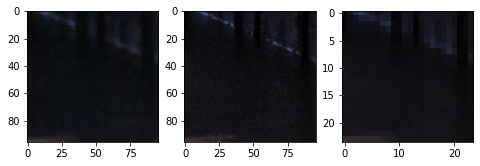

In [235]:
train = DataLoader(train_set, batch_size=1, num_workers=4, shuffle=True)
netG.eval()

inputs, classes = next(iter(train))   

out = netG(inputs.to(device))

fig, axs = plt.subplots(1, 3,figsize=(8,8))

axs[0].imshow(np.transpose(out[0].cpu().detach().numpy(), (1, 2, 0)))
axs[1].imshow(np.transpose(classes[0].cpu().detach().numpy(), (1, 2, 0)))
axs[2].imshow(np.transpose(inputs[0].cpu().detach().numpy(), (1, 2, 0)))



In [236]:
import plotly.graph_objects as go


# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=[i for i in range(len(train_gen_losses))], y=train_gen_losses,
                    mode='lines',
                    name='Gen'))
fig.add_trace(go.Scatter(x=[i for i in range(len(train_gen_losses))], y=train_disc_losses,
                    mode='lines',
                    name='Disc'))


fig.show()

In [52]:

with ZipFile('Test Dataset.zip', 'r') as zip:
  zip.extractall()
  print('Done')

Done


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning:

volatile was removed and now has no effect. Use `with torch.no_grad():` instead.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning:

volatile was removed and now has no effect. Use `with torch.no_grad():` instead.



66.66612657404035

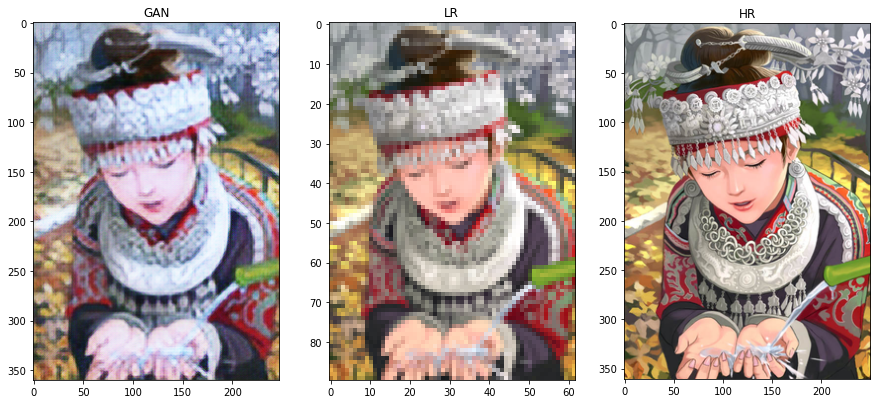

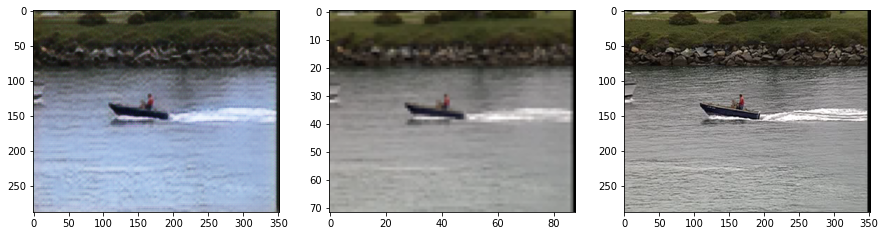

In [237]:
import matplotlib.pyplot as plt
IMAGE_NAME = '/content/comicx4.png'
image = Image.open(IMAGE_NAME)
image = Variable(ToTensor()(image), volatile=True).unsqueeze(0)

IMAGE_NAME = '/content/coastguardx4.png'
image1 = Image.open(IMAGE_NAME)
image1 = Variable(ToTensor()(image1), volatile=True).unsqueeze(0)

IMAGE_NAME = '/content/coastguard.png'
image1_real = Image.open(IMAGE_NAME)
image1_real = Variable(ToTensor()(image1_real)).unsqueeze(0)

IMAGE_NAME = '/content/comic.png'
image_real = Image.open(IMAGE_NAME)
image_real = Variable(ToTensor()(image_real)).unsqueeze(0)



image = image.cuda()
out = netG(image)
#out = netG(out)


fig, axs = plt.subplots(1, 3,figsize=(15,15))

axs[0].imshow(np.transpose(out[0].cpu().detach().numpy(), (1, 2, 0)))
axs[0].title.set_text('GAN')

axs[1].imshow(np.transpose(image[0].cpu().detach().numpy(), (1, 2, 0)))
axs[1].title.set_text('LR')

axs[2].imshow(np.transpose(image_real[0].cpu().detach().numpy(), (1, 2, 0)))
axs[2].title.set_text('HR')



image1 = image1.cuda()

out1 = netG(image1)
fig, axs = plt.subplots(1, 3,figsize=(15,15))

axs[0].imshow(np.transpose(out1[0].cpu().detach().numpy(), (1, 2, 0)))
axs[1].imshow(np.transpose(image1[0].cpu().detach().numpy(), (1, 2, 0)))
axs[2].imshow(np.transpose(image1_real[0].cpu().detach().numpy(), (1, 2, 0)))


import math
import numpy as np
import cv2

def calculate_psnr(img1, img2):
    # img1 and img2 have range [0, 255]
    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)
    img2 = img2.reshape(img1.shape)
    mse = np.mean((img1 - img2)**2)
    if mse == 0:
        return float('inf')
    return 20 * math.log10(255.0 / math.sqrt(mse))

calculate_psnr(np.transpose(out1[0].cpu().detach().numpy(), (1, 2, 0)), np.transpose(image1_real[0].cpu().detach().numpy(), (1, 2, 0)))


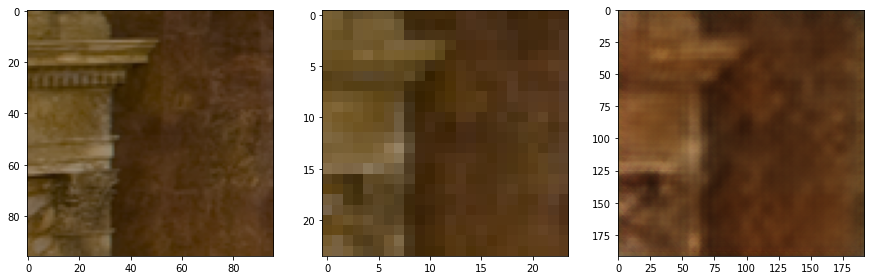

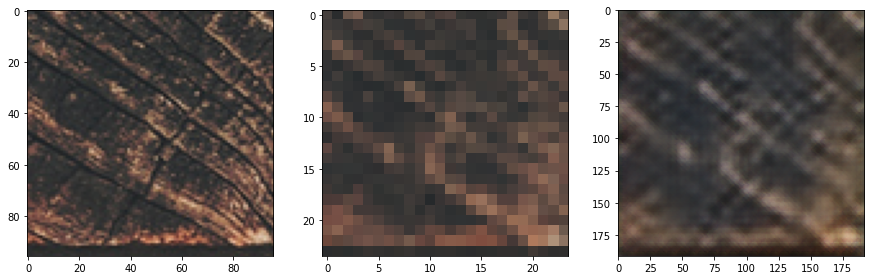

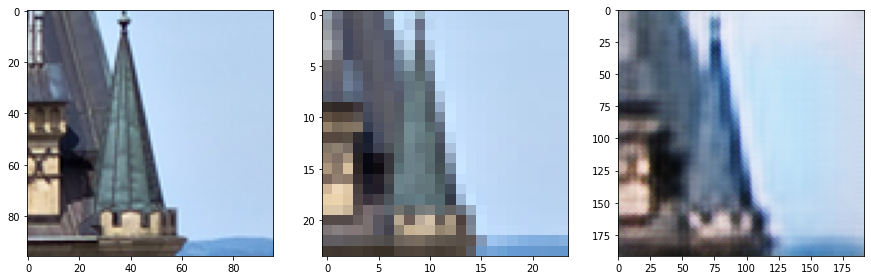

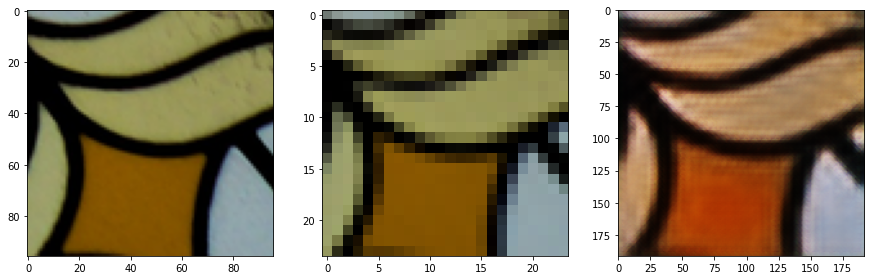

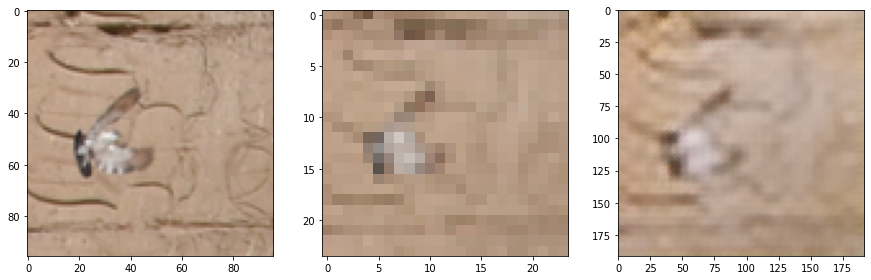

...

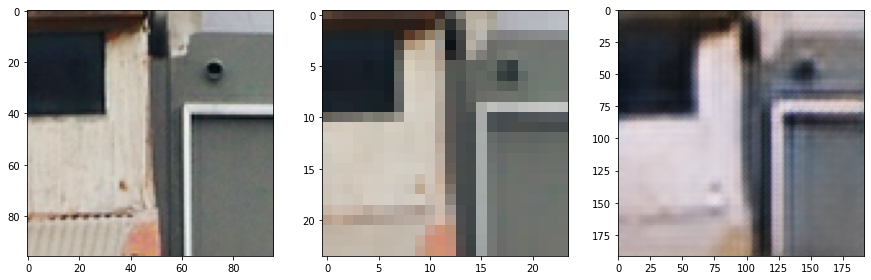

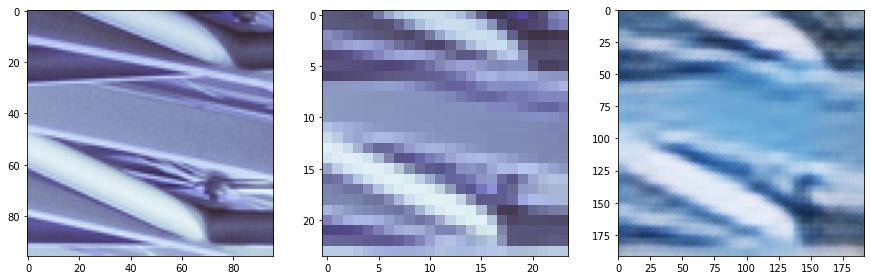

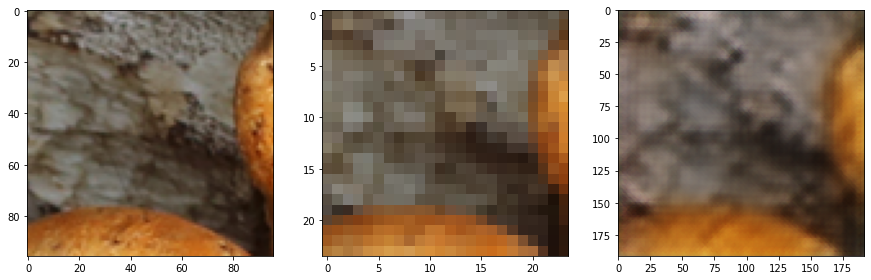

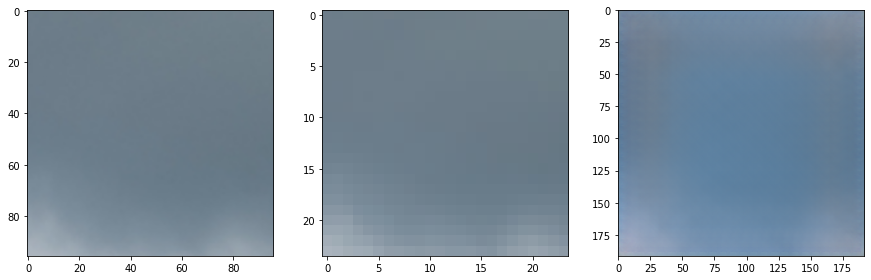

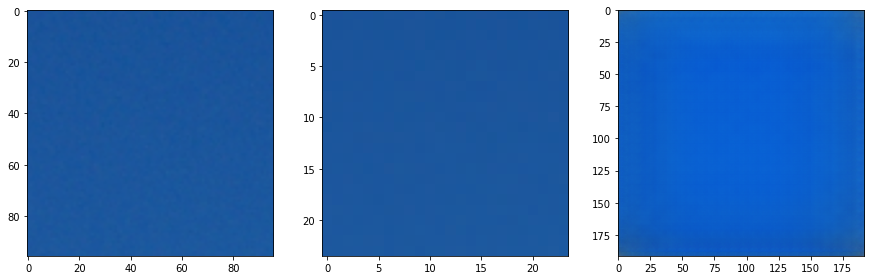

In [206]:
import matplotlib.pyplot as plt                            

valid_set = TrainDatasetFromFolder("DIV2K_valid_HR", crop_size=96,
                                 upscale_factor=4)
validloader = DataLoader(valid_set, batch_size=1)
netG.eval()
netD.eval()
for data, target in  validloader:# next(iter(validloader))
    real_img = Variable(target)
    real_img = real_img.to(device)
    z = Variable(data)
    z = z.to(device)
    gen_img = netG(z)

    fig, axs = plt.subplots(1, 3,figsize=(15,15))

    axs[0].imshow(np.transpose(target[0].cpu().detach().numpy(), (1, 2, 0)))
    #plt.show()
    axs[1].imshow(np.transpose(data[0].cpu().detach().numpy(), (1, 2, 0)))
    #plt.show()
    axs[2].imshow(np.transpose(gen_img[0].cpu().detach().numpy(), (1, 2, 0)))
    plt.show()
    




In [ ]:
# We will just make sure that this model trains 5 epochs successfuly
# This will take around 2 hours to train, please monitor colab
# To make sure that it does not time out
# There might be few errors, mostly due to typos
# The progress bar acts slightly weird
# But you see the model is now training


### Set14 image

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning:

volatile was removed and now has no effect. Use `with torch.no_grad():` instead.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning:

volatile was removed and now has no effect. Use `with torch.no_grad():` instead.



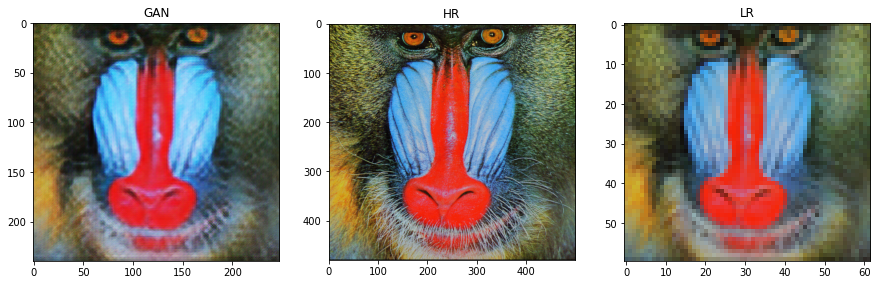

In [238]:
import matplotlib.pyplot as plt
IMAGE_NAME = '/content/Test Dataset/Test_data/Set14/HR/baboon.png'
HR = Image.open(IMAGE_NAME)
HR = Variable(ToTensor()(HR), volatile=True).unsqueeze(0)

IMAGE_NAME = '/content/Test Dataset/Test_data/Set14/LR_bicubic/X8/baboonx8.png'
LR = Image.open(IMAGE_NAME)
LR = Variable(ToTensor()(LR), volatile=True).unsqueeze(0)


LR = LR.cuda()
out = netG(LR)


fig, axs = plt.subplots(1, 3,figsize=(15,15))

axs[0].imshow(np.transpose(out[0].cpu().detach().numpy(), (1, 2, 0)))
axs[0].title.set_text('GAN')

axs[1].imshow(np.transpose(HR[0].cpu().detach().numpy(), (1, 2, 0)))
axs[1].title.set_text('HR')

axs[2].imshow(np.transpose(LR[0].cpu().detach().numpy(), (1, 2, 0)))
axs[2].title.set_text('LR')



## Testing on Set5 and PSNR calculation

In [239]:
class TestDatasetFromFolder(Dataset):
    def __init__(self, dataset_dir, upscale_factor):
        super(TestDatasetFromFolder, self).__init__()
        self.lr_path = dataset_dir + '/Set5/LR_bicubic/X4/'
        self.hr_path = dataset_dir + '/Set5/HR/'
        self.upscale_factor = upscale_factor
        self.lr_filenames = [join(self.lr_path, x) for x in listdir(self.lr_path) if is_image_file(x)]
        self.lr_filenames=sorted(self.lr_filenames)
        self.hr_filenames = [join(self.hr_path, x) for x in listdir(self.hr_path) if is_image_file(x)]
        self.hr_filenames  = sorted(self.hr_filenames )

    def __getitem__(self, index):
        image_name = self.lr_filenames[index].split('/')[-1]
        lr_image = Image.open(self.lr_filenames[index])
        w, h = lr_image.size
        hr_image = Image.open(self.hr_filenames[index])
        hr_scale = Resize((self.upscale_factor * h, self.upscale_factor * w), interpolation=Image.BICUBIC)
        hr_restore_img = hr_scale(lr_image)
        return image_name, ToTensor()(lr_image), ToTensor()(hr_restore_img), ToTensor()(hr_image)

    def __len__(self):
        return len(self.lr_filenames)

def display_transform():
    return Compose([
        ToPILImage(),
        Resize(400),
        CenterCrop(400),
        ToTensor()
    ])


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

[testing benchmark datasets]:   0%|          | 0/5 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning:

Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning:

Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333:

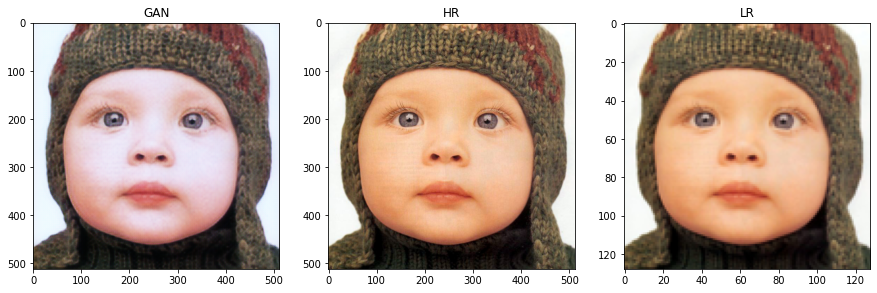

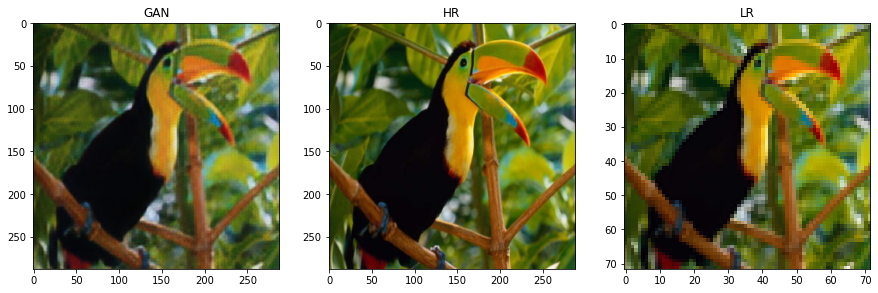

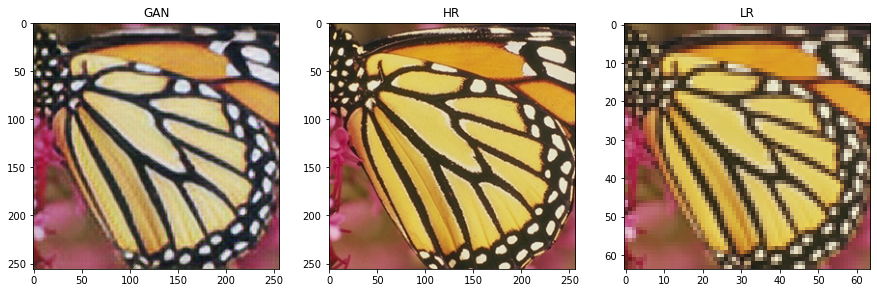

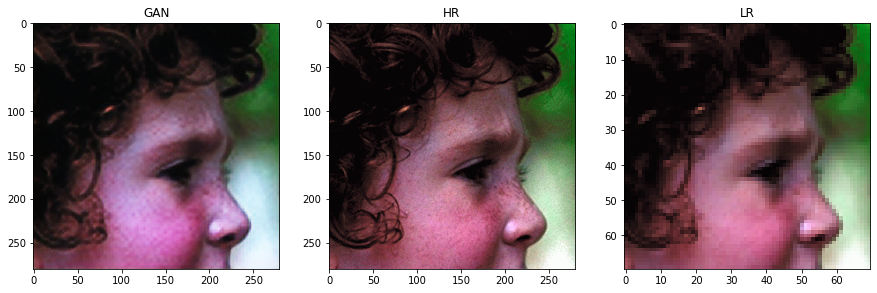

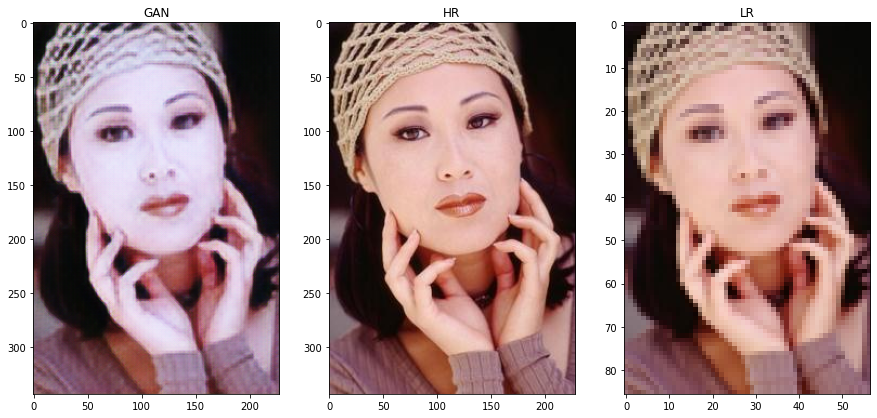

In [240]:
import argparse
import os
from math import log10

import numpy as np
import pandas as pd
import torch
import torchvision.utils as utils
from torch.autograd import Variable
from torch.utils.data import DataLoader
from tqdm import tqdm

import os
import time 
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import tensorflow as tf

import pytorch_ssim


UPSCALE_FACTOR = 8

results = {'Set5': {'psnr': []}, 'Set14': {'psnr': []}, 'BSD100': {'psnr': []},
           'Urban100': {'psnr': []}}

model = netG.eval()
if torch.cuda.is_available():
    model = model.cuda()


test_set = TestDatasetFromFolder('/content/Test Dataset/Test_data', upscale_factor=UPSCALE_FACTOR)
test_loader = DataLoader(dataset=test_set, num_workers=4, batch_size=1, shuffle=False)
test_bar = tqdm(test_loader, desc='[testing benchmark datasets]')

out_path = 'benchmark_results/SRF_' + str(UPSCALE_FACTOR) + '/'
if not os.path.exists(out_path):
    os.makedirs(out_path)

for image_name, lr_image, hr_restore_img, hr_image in test_bar:
    image_name = image_name[0]
    lr_image = Variable(lr_image, volatile=True)
    hr_image = Variable(hr_image, volatile=True)
    if torch.cuda.is_available():
        lr_image = lr_image.cuda()
        hr_image = hr_image.cuda()

    sr_image = model(lr_image)
    fig, axs = plt.subplots(1, 3,figsize=(15,15))

    axs[0].imshow(np.transpose(sr_image[0].cpu().detach().numpy(), (1, 2, 0)))
    axs[0].title.set_text('GAN')

    axs[1].imshow(np.transpose(hr_image[0].cpu().detach().numpy(), (1, 2, 0)))
    axs[1].title.set_text('HR')

    axs[2].imshow(np.transpose(lr_image[0].cpu().detach().numpy(), (1, 2, 0)))
    axs[2].title.set_text('LR')

    #psnr = tf.image.psnr(
    #tf.clip_by_value(lr_image.data.cpu(), 0, 255),
    #tf.clip_by_value(preprocess_image(hr_image.data.cpu()), 0, 255), max_val=255)
    
    mse = ((hr_image.data.cpu().squeeze(0) - sr_image.data.cpu().squeeze(0)) ** 2).data.mean()
    psnr = 10 * log10(1 / mse)
#    ssim = pytorch_ssim.ssim(sr_image.data.cpu().squeeze(0), hr_image.data.cpu().squeeze(0)).data[0]
#
    test_images = torch.stack(
       [display_transform()(hr_restore_img.squeeze(0)), display_transform()(hr_image.data.cpu().squeeze(0)),
        display_transform()(sr_image.data.cpu().squeeze(0))])
    image = utils.make_grid(test_images, nrow=3, padding=5)
    utils.save_image(image, out_path + image_name.split('.')[0]  + "."+image_name.split('.')[-1], padding=5)

#     # save psnr\ssim
#   results[image_name.split('_')[0]]['psnr'].append(psnr)
#   results[image_name.split('_')[0]]['ssim'].append(ssim)
    results['Set5']['psnr'].append(psnr)


# out_path = 'statistics/'
# saved_results = {'psnr': []}
# for item in results.values():
#     psnr = np.array(item['psnr'])
#     # ssim = np.array(item['ssim'])
#     if (len(psnr) == 0):# or (len(ssim) == 0):
#         psnr = 'No data'
#         #ssim = 'No data'
#     else:
#         psnr = psnr.mean()
#         #ssim = ssim.mean()
#     saved_results['psnr'].append(psnr)
#     #saved_results['ssim'].append(ssim)

# data_frame = pd.DataFrame(saved_results, results.keys())
# #data_frame.to_csv(out_path + 'srf_' + str(UPSCALE_FACTOR) + '_test_results.csv', index_label='DataSet')

In [241]:
np.mean(results['Set5']['psnr'])

21.335350337403497